In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
import tensorflow.keras.backend as K
from tensorflow.keras import backend as K

In [ ]:
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import random
import os
import pathlib
import tensorflow.keras.backend as K
from keras.applications import MobileNetV2
from tensorflow.keras.utils import get_custom_objects
from tensorflow.keras.layers import Input, concatenate, GlobalAveragePooling2D, Dense, Dropout, BatchNormalization
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import itertools

In [ ]:
data_dir = '/content/gdrive/MyDrive/pill-today/pill-ai/pill/EDA/Data/data_100/'  # 'Dataset' 폴더명은 압축 파일 내용에 따라 변경 가능
path_dir = pathlib.Path(data_dir)

In [ ]:
train_dir = path_dir / 'train'
validation_dir = path_dir / 'val'
test_dir = path_dir / 'test'

In [ ]:
IMG_WIDTH = 224
IMG_HEIGHT = 224
BATCH_SIZE = 32

In [ ]:
# 이미지 데이터 생성기 설정
train_datagen = ImageDataGenerator(rescale=1./255)
validation_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)

In [ ]:
input_shape = (IMG_HEIGHT, IMG_WIDTH, 3)
front_input = Input(shape=input_shape, name='front_input')
back_input = Input(shape=input_shape, name='back_input')

In [ ]:
# Instantiate the model with the pre-trained weights (no top)
conv_base = MobileNetV2(weights='imagenet',
                  include_top=False,
                  input_shape=input_shape)

9406464/9406464 [==============================] - 0s 0us/step


In [ ]:
front_features = conv_base(front_input)
back_features = conv_base(back_input)

In [ ]:
# Show the architecture
conv_base.summary()

Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 Conv1 (Conv2D)              (None, 112, 112, 32)         864       ['input_1[0][0]']             
                                                                                                  
 bn_Conv1 (BatchNormalizati  (None, 112, 112, 32)         128       ['Conv1[0][0]']               
 on)                                                                                              
                                                                                                  
 Conv1_relu (ReLU)           (None, 112, 112, 32)         0         ['bn_Conv1[

In [ ]:
# 커스텀 모델 생성
# 특징 병합
merged_features = concatenate([front_features, back_features], axis=-1)
pooled_features = GlobalAveragePooling2D()(merged_features)

# 추가 레이어
hidden_layer = Dense(128, activation='relu')(pooled_features)
hidden_layer = BatchNormalization()(hidden_layer)
dropout_layer = Dropout(0.5)(hidden_layer)
classification_layer = Dense(70, activation='softmax')(dropout_layer)

# 모델 생성
model = Model(inputs=[front_input, back_input], outputs=classification_layer)

# # 컨볼루션 베이스 동결 (선택적)
# conv_base.trainable = False

# 일부 레이어의 동결 해제
for layer in conv_base.layers[-4:]:
    layer.trainable = True

In [ ]:
from tensorflow.keras.optimizers import Adam

# 모델 컴파일
model.compile(optimizer=Adam(learning_rate=0.00001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 front_input (InputLayer)    [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 back_input (InputLayer)     [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 mobilenetv2_1.00_224 (Func  (None, 7, 7, 1280)           2257984   ['front_input[0][0]',         
 tional)                                                             'back_input[0][0]']          
                                                                                                  
 concatenate (Concatenate)   (None, 7, 7, 2560)           0         ['mobilenetv2_1.00_224[0][

In [ ]:
# 데이터 증강 설정
data_gen_args = {
    'rotation_range': 30,
    'width_shift_range': 0.2,
    'height_shift_range': 0.2,
    'shear_range': 0.2,
    'zoom_range': 0.2,
    'horizontal_flip': True,
    'brightness_range': [0.8, 1.2],
    'fill_mode': 'nearest'
}

# ImageDataGenerator 인스턴스 생성
image_datagen = ImageDataGenerator(**data_gen_args)

In [ ]:
from tensorflow.keras.utils import to_categorical
import numpy as np
from tensorflow.keras.utils import Sequence
from tensorflow.keras.preprocessing.image import img_to_array, load_img
import os

class DualImageGenerator(Sequence):
    def __init__(self, data_dir, batch_size, num_classes, img_size=(224, 224), shuffle=True):
        self.batch_size = batch_size
        self.num_classes = num_classes
        self.img_size = img_size
        self.data_dir = data_dir
        self.front_images = []
        self.back_images = []
        self.labels = []
        self.shuffle = shuffle
        self.label_map = self.create_label_map(data_dir)
        self.on_epoch_end()
        # 이미지 파일과 라벨을 준비합니다
        for label_folder in os.listdir(data_dir):
            front_images_dir = os.path.join(data_dir, label_folder, 'front_size')
            back_images_dir = os.path.join(data_dir, label_folder, 'back_size')
            front_images = sorted(os.listdir(front_images_dir))
            back_images = sorted(os.listdir(back_images_dir))
            label_index = self.label_map[label_folder]  # 폴더명을 정수 인덱스로 변환
            for f_img, b_img in zip(front_images, back_images):
                self.front_images.append(os.path.join(front_images_dir, f_img))
                self.back_images.append(os.path.join(back_images_dir, b_img))
                self.labels.append(label_index)

    def create_label_map(self, data_dir):
        label_folders = os.listdir(data_dir)
        return {label: idx for idx, label in enumerate(label_folders)}

    def __len__(self):
        return int(np.floor(len(self.front_images) / self.batch_size))

    def __getitem__(self, index):
        batch_front = self.front_images[index*self.batch_size:(index+1)*self.batch_size]
        batch_back = self.back_images[index*self.batch_size:(index+1)*self.batch_size]
        batch_labels = self.labels[index*self.batch_size:(index+1)*self.batch_size]
        return self.__data_generation(batch_front, batch_back, batch_labels)

    def on_epoch_end(self):
        if self.shuffle:
            indices = np.arange(len(self.front_images))
            np.random.shuffle(indices)
            self.front_images = np.array(self.front_images)[indices].tolist()
            self.back_images = np.array(self.back_images)[indices].tolist()
            self.labels = np.array(self.labels)[indices].tolist()

    def __data_generation(self, front_files, back_files, labels):
        X_front = np.zeros((self.batch_size, *self.img_size, 3))
        X_back = np.zeros((self.batch_size, *self.img_size, 3))
        y_class = np.zeros((self.batch_size, self.num_classes))

        for i, (front_file, back_file) in enumerate(zip(front_files, back_files)):
            try:
                front_img = load_img(front_file, target_size=self.img_size)
                back_img = load_img(back_file, target_size=self.img_size)
                # print(f"Loaded images: {front_file}, {back_file}")
                # print(f"Original front image size: {front_img.size}, back image size: {back_img.size}")

                # PIL 이미지를 numpy 배열로 변환
                front_img = img_to_array(front_img)
                back_img = img_to_array(back_img)

                # TensorFlow를 사용하여 크기 조정
                front_img = tf.image.resize(front_img, self.img_size, preserve_aspect_ratio=True)
                back_img = tf.image.resize(back_img, self.img_size, preserve_aspect_ratio=True)
                # print(f"Resized front image size: {front_img.shape}, back image size: {back_img.shape}")

                # 데이터 증강 적용
                front_img = self.augment_image(front_img)
                back_img = self.augment_image(back_img)

                X_front[i,] = img_to_array(front_img) / 255.0
                X_back[i,] = img_to_array(back_img) / 255.0
                y_class[i,] = to_categorical(labels[i], num_classes=self.num_classes)
            except Exception as e:
                print(f"Error loading image {front_file} or {back_file}: {e}")

        return [X_front, X_back], y_class

    def augment_image(self, image):
        image = tf.image.random_flip_left_right(image)
        image = tf.image.random_flip_up_down(image)
        image = tf.image.random_brightness(image, max_delta=0.1)
        image = tf.image.random_contrast(image, lower=0.9, upper=1.1)
        image = tf.image.random_hue(image, max_delta=0.05)
        image = tf.image.random_saturation(image, lower=0.9, upper=1.1)
        return image.numpy()


In [ ]:
# 모델 학습에 사용할 데이터 생성기 인스턴스 생성
train_generator = DualImageGenerator(
    data_dir=train_dir,
    batch_size=BATCH_SIZE,
    num_classes=70,  # 적절한 클래스 수로 설정해야 함, 예제에서는 61로 가정
    img_size=(224, 224),
    shuffle=True
)

validation_generator = DualImageGenerator(
    data_dir=validation_dir,
    batch_size=BATCH_SIZE,
    num_classes=70,
    img_size=(224, 224),
    shuffle=True
)

test_generator = DualImageGenerator(
    data_dir=test_dir,
    batch_size=BATCH_SIZE,
    num_classes=70,
    img_size=(224, 224),
    shuffle=False  # 테스트 데이터는 일반적으로 셔플하지 않음
)

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint

# 체크포인트 콜백 설정
checkpoint_filepath = '/content/gdrive/MyDrive/pill-today/pill-ai/pill/model/saved_model_mobilenetv2_ver2/checkpoint-{epoch:02d}-{val_loss:.2f}.h5'
checkpoint_callback = ModelCheckpoint(filepath=checkpoint_filepath, save_weights_only=True, verbose=1, save_best_only=True)

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

# 조기 종료 콜백 설정
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=5, verbose=1)

# 학습률 감소 콜백 설정
# 60?이 표준 일단 44까지는 factor=0.2, patience=3 으로 선정
# 80 진행 시, 45부터 시작 시는
reduce_lr_callback = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6, verbose=1)

In [ ]:
# 모델 훈련
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),  # 모든 샘플이 훈련되도록 설정
    epochs=20,
    validation_data=validation_generator,
    validation_steps=len(validation_generator),  # 모든 샘플이 검증되도록 설정
    callbacks=[checkpoint_callback, early_stopping_callback, reduce_lr_callback]
)

Epoch 1/20
131/131 [==============================] - ETA: 0s - loss: 5.2992 - accuracy: 0.0165
Epoch 1: val_loss improved from inf to 4.74153, saving model to /content/gdrive/MyDrive/pill-today/pill-ai/pill/model/saved_model_mobilenetv2_ver2/checkpoint-01-4.74.h5
131/131 [==============================] - 744s 6s/step - loss: 5.2992 - accuracy: 0.0165 - val_loss: 4.7415 - val_accuracy: 0.0087 - lr: 1.0000e-05
Epoch 2/20
131/131 [==============================] - ETA: 0s - loss: 4.7062 - accuracy: 0.0353
Epoch 2: val_loss improved from 4.74153 to 4.62367, saving model to /content/gdrive/MyDrive/pill-today/pill-ai/pill/model/saved_model_mobilenetv2_ver2/checkpoint-02-4.62.h5
131/131 [==============================] - 387s 3s/step - loss: 4.7062 - accuracy: 0.0353 - val_loss: 4.6237 - val_accuracy: 0.0196 - lr: 1.0000e-05
Epoch 3/20
131/131 [==============================] - ETA: 0s - loss: 3.9887 - accuracy: 0.1014
Epoch 3: val_loss improved from 4.62367 to 4.56169, saving model to /con

In [ ]:
# 학습 후 모델 저장
model.save('/content/gdrive/MyDrive/pill-today/pill-ai/pill/model/saved_model_mobilenetv2_ver2/my_model_20epochs.keras')

In [ ]:
# 기존 모델을 더 학습시키기 위한 코드
additional_epochs = 10  # 추가할 에폭 수

history_additional = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=additional_epochs,
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[checkpoint_callback, early_stopping_callback, reduce_lr_callback]
)

Epoch 1/10
131/131 [==============================] - ETA: 0s - loss: 0.5589 - accuracy: 0.8934
Epoch 1: val_loss improved from 0.28734 to 0.26268, saving model to /content/gdrive/MyDrive/pill-today/pill-ai/pill/model/saved_model_mobilenetv2_ver2/checkpoint-01-0.26.h5
131/131 [==============================] - 362s 3s/step - loss: 0.5589 - accuracy: 0.8934 - val_loss: 0.2627 - val_accuracy: 0.9484 - lr: 1.0000e-05
Epoch 2/10
131/131 [==============================] - ETA: 0s - loss: 0.5081 - accuracy: 0.9003
Epoch 2: val_loss improved from 0.26268 to 0.23697, saving model to /content/gdrive/MyDrive/pill-today/pill-ai/pill/model/saved_model_mobilenetv2_ver2/checkpoint-02-0.24.h5
131/131 [==============================] - 358s 3s/step - loss: 0.5081 - accuracy: 0.9003 - val_loss: 0.2370 - val_accuracy: 0.9549 - lr: 1.0000e-05
Epoch 3/10
131/131 [==============================] - ETA: 0s - loss: 0.4697 - accuracy: 0.9122
Epoch 3: val_loss improved from 0.23697 to 0.22786, saving model to 

In [ ]:
# 학습 후 모델 저장
model.save('/content/gdrive/MyDrive/pill-today/pill-ai/pill/model/saved_model_mobilenetv2_ver2/my_model_30epochs.keras')

In [ ]:
# 기존 모델을 더 학습시키기 위한 코드
additional_epochs = 10  # 추가할 에폭 수

history_additional_2 = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=additional_epochs,
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[checkpoint_callback, early_stopping_callback, reduce_lr_callback]
)

Epoch 1/10
131/131 [==============================] - ETA: 0s - loss: 0.2756 - accuracy: 0.9561
Epoch 1: val_loss improved from 0.13695 to 0.13609, saving model to /content/gdrive/MyDrive/pill-today/pill-ai/pill/model/saved_model_mobilenetv2_ver2/checkpoint-01-0.14.h5
131/131 [==============================] - 364s 3s/step - loss: 0.2756 - accuracy: 0.9561 - val_loss: 0.1361 - val_accuracy: 0.9637 - lr: 1.0000e-05
Epoch 2/10
131/131 [==============================] - ETA: 0s - loss: 0.2609 - accuracy: 0.9542
Epoch 2: val_loss improved from 0.13609 to 0.11131, saving model to /content/gdrive/MyDrive/pill-today/pill-ai/pill/model/saved_model_mobilenetv2_ver2/checkpoint-02-0.11.h5
131/131 [==============================] - 355s 3s/step - loss: 0.2609 - accuracy: 0.9542 - val_loss: 0.1113 - val_accuracy: 0.9775 - lr: 1.0000e-05
Epoch 3/10
131/131 [==============================] - ETA: 0s - loss: 0.2567 - accuracy: 0.9566
Epoch 3: val_loss did not improve from 0.11131
131/131 [============

In [ ]:
# 학습 후 모델 저장
model.save('/content/gdrive/MyDrive/pill-today/pill-ai/pill/model/saved_model_mobilenetv2_ver2/my_model_40epochs.keras')

In [ ]:
history_additional_3 = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=additional_epochs,
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[checkpoint_callback, early_stopping_callback, reduce_lr_callback]
)

Epoch 1/10
131/131 [==============================] - ETA: 0s - loss: 0.1471 - accuracy: 0.9792
Epoch 1: val_loss improved from 0.07188 to 0.06676, saving model to /content/gdrive/MyDrive/pill-today/pill-ai/pill/model/saved_model_mobilenetv2_ver2/checkpoint-01-0.07.h5
131/131 [==============================] - 358s 3s/step - loss: 0.1471 - accuracy: 0.9792 - val_loss: 0.0668 - val_accuracy: 0.9847 - lr: 1.0000e-05
Epoch 2/10
131/131 [==============================] - ETA: 0s - loss: 0.1486 - accuracy: 0.9778
Epoch 2: val_loss improved from 0.06676 to 0.06167, saving model to /content/gdrive/MyDrive/pill-today/pill-ai/pill/model/saved_model_mobilenetv2_ver2/checkpoint-02-0.06.h5
131/131 [==============================] - 359s 3s/step - loss: 0.1486 - accuracy: 0.9778 - val_loss: 0.0617 - val_accuracy: 0.9869 - lr: 1.0000e-05
Epoch 3/10
131/131 [==============================] - ETA: 0s - loss: 0.1347 - accuracy: 0.9816
Epoch 3: val_loss did not improve from 0.06167
131/131 [============

In [ ]:
# 학습 후 모델 저장
model.save('/content/gdrive/MyDrive/pill-today/pill-ai/pill/model/saved_model_mobilenetv2_ver2/my_model_50epochs.keras')

In [ ]:
# 모델 구조 저장
model_json = model.to_json()
with open('/content/gdrive/MyDrive/pill-today/pill-ai/pill/model/saved_model_mobilenetv2_ver2/model.json', 'w') as json_file:
    json_file.write(model_json)

In [ ]:
# 모델 가중치 저장
model.save_weights('/content/gdrive/MyDrive/pill-today/pill-ai/pill/model/saved_model_mobilenetv2_ver2/model_weights.h5')

Label: K-038967, Index: 0


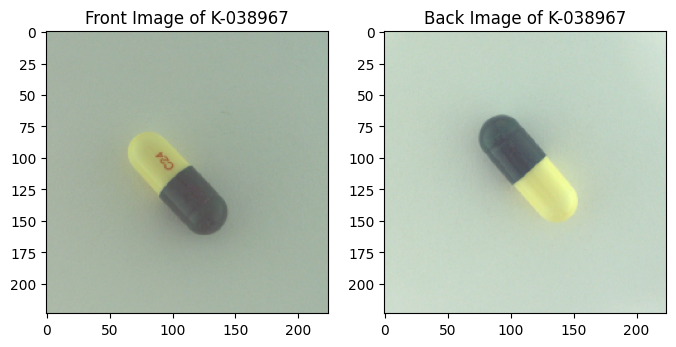

Label: K-039036, Index: 1


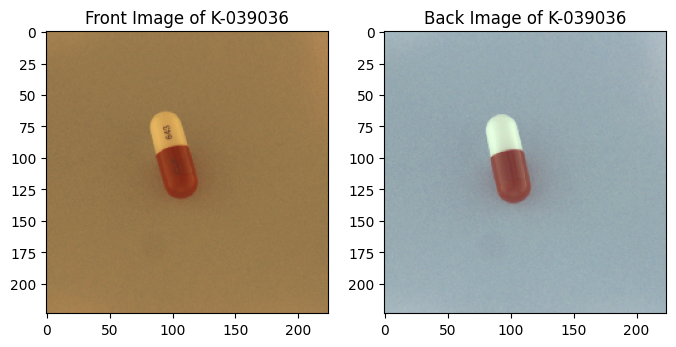

Label: K-038970, Index: 2


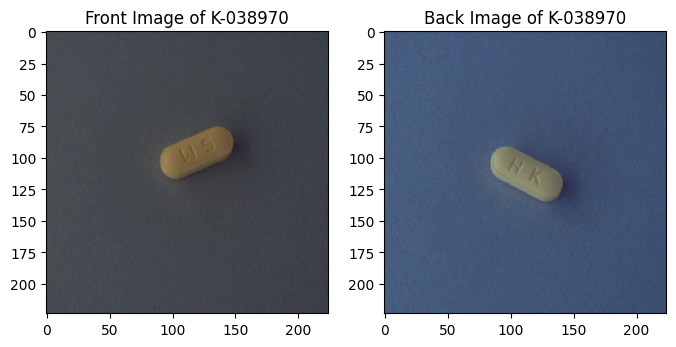

Label: K-039021, Index: 3


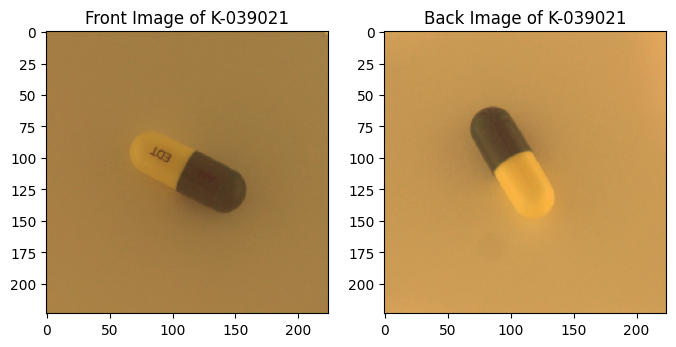

Label: K-039047, Index: 4


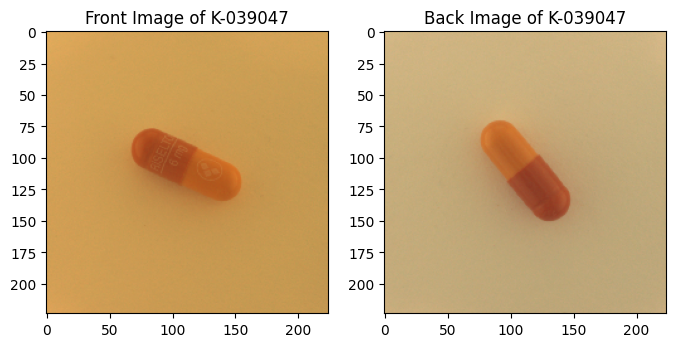

Label: K-039108, Index: 5


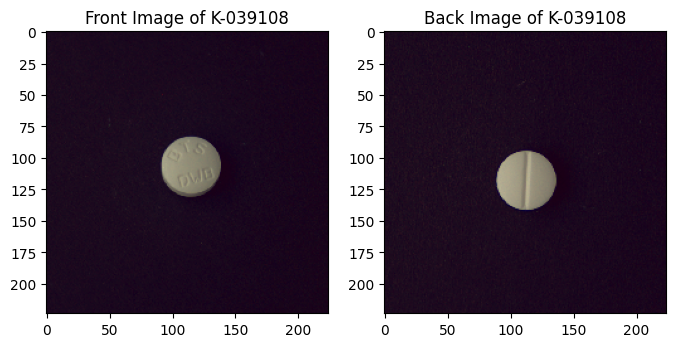

Label: K-039123, Index: 6


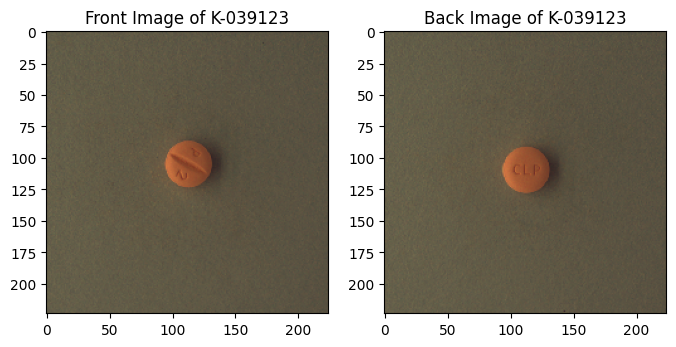

Label: K-039104, Index: 7


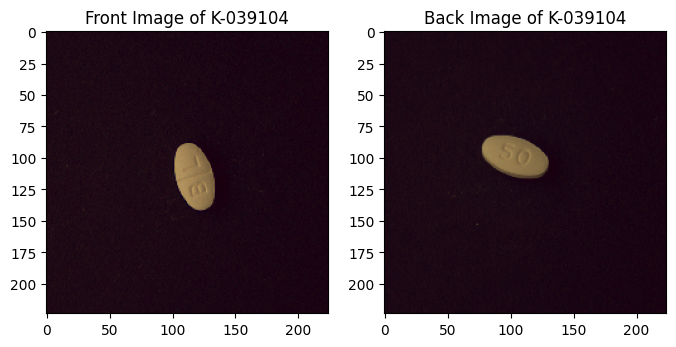

Label: K-038884, Index: 8


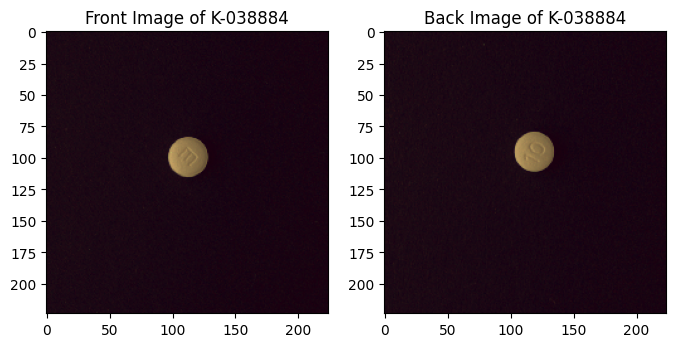

Label: K-038890, Index: 9


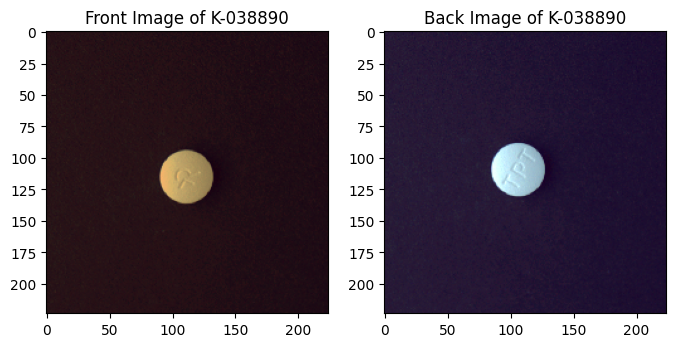

Label: K-038896, Index: 10


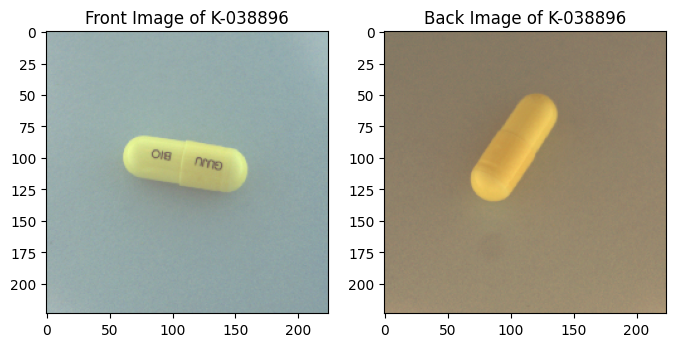

Label: K-038910, Index: 11


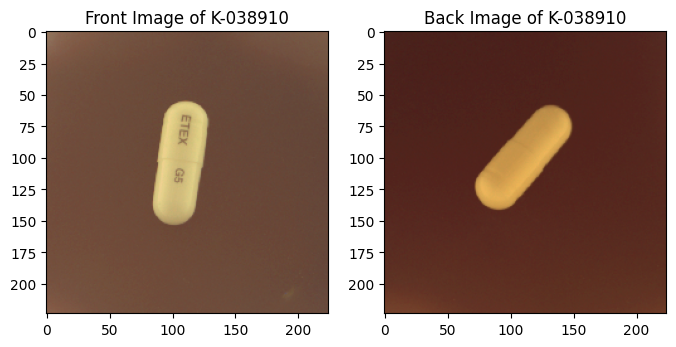

Label: K-038927, Index: 12


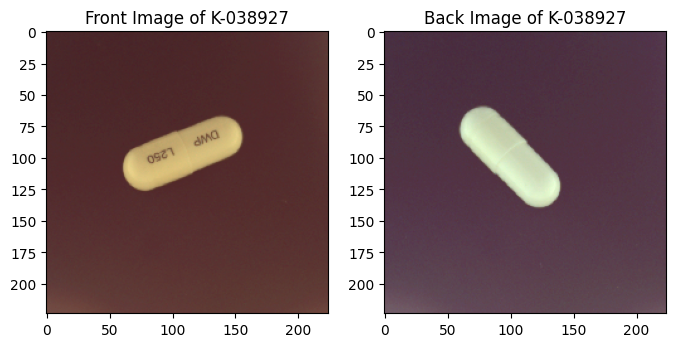

Label: K-038912, Index: 13


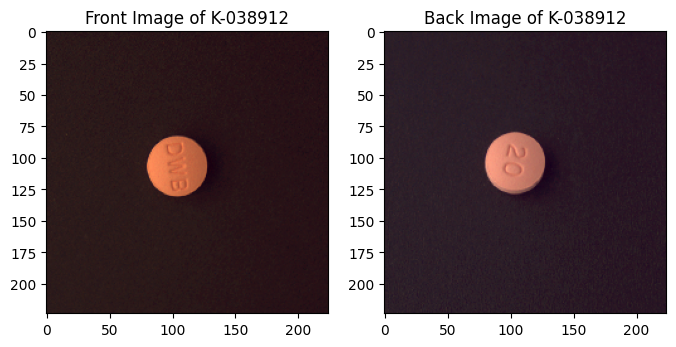

Label: K-038929, Index: 14


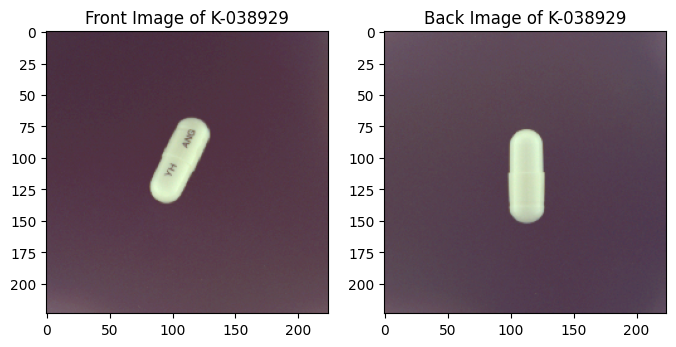

Label: K-038954, Index: 15


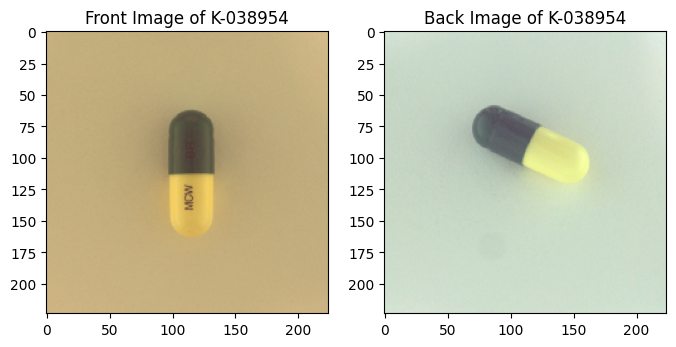

Label: K-038958, Index: 16


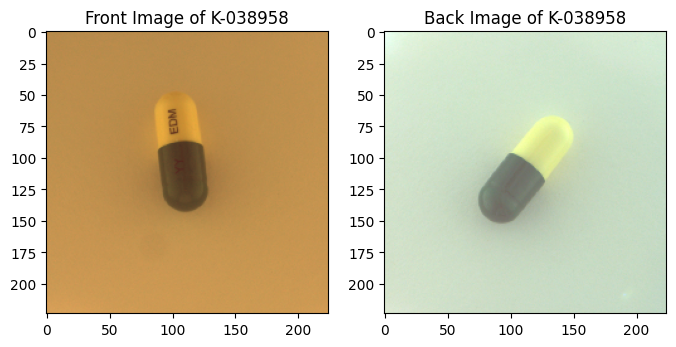

Label: K-038959, Index: 17


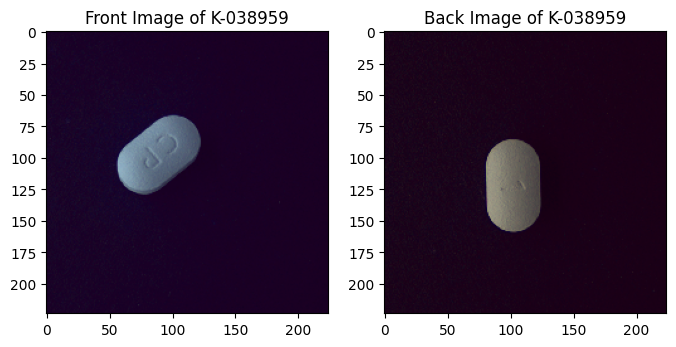

Label: K-038962, Index: 18


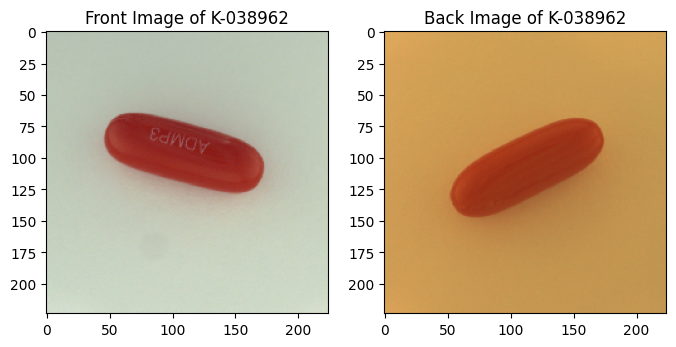

Label: K-036018, Index: 19


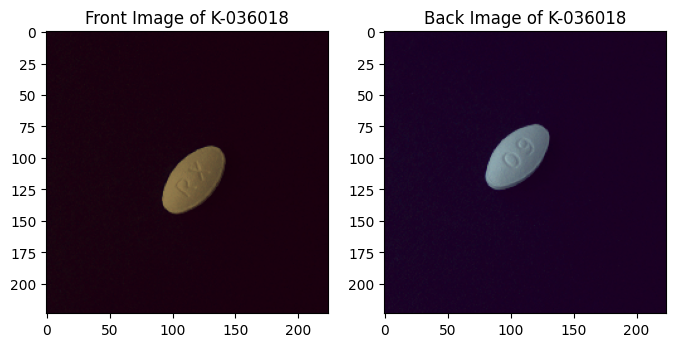

Label: K-036025, Index: 20


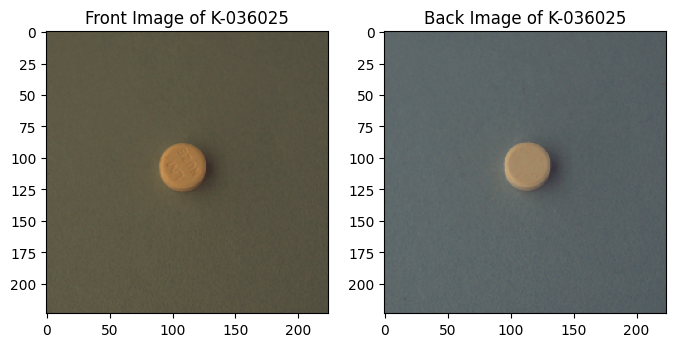

Label: K-036032, Index: 21


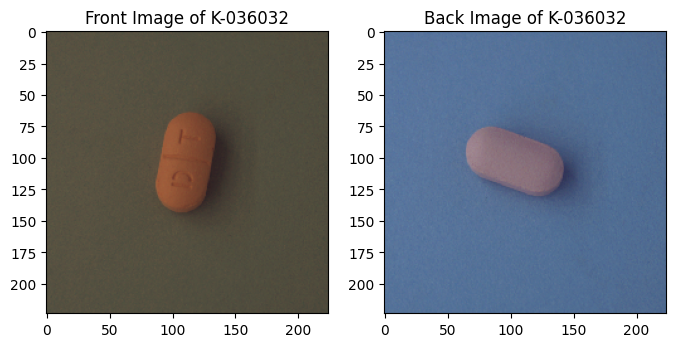

Label: K-036039, Index: 22


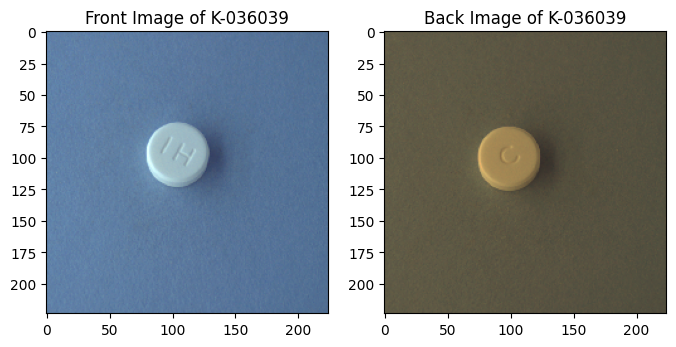

Label: K-036055, Index: 23


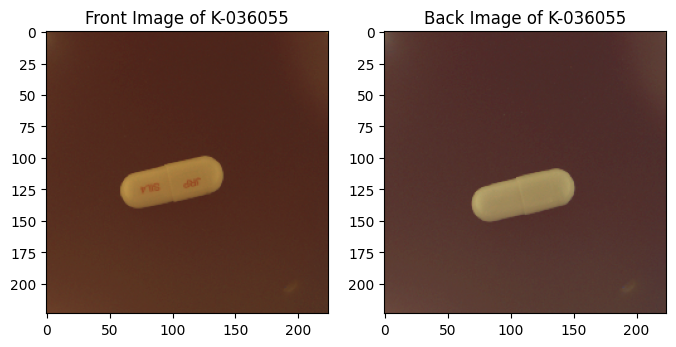

Label: K-036058, Index: 24


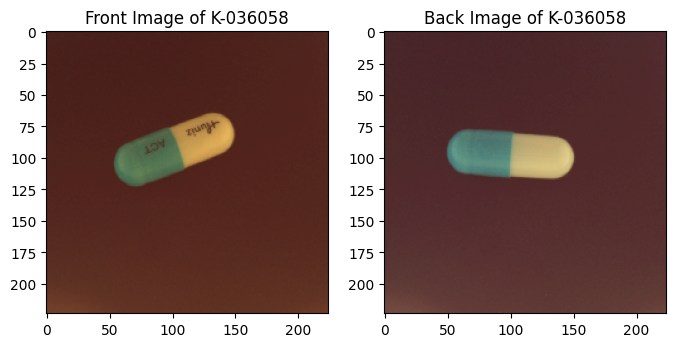

Label: K-036076, Index: 25


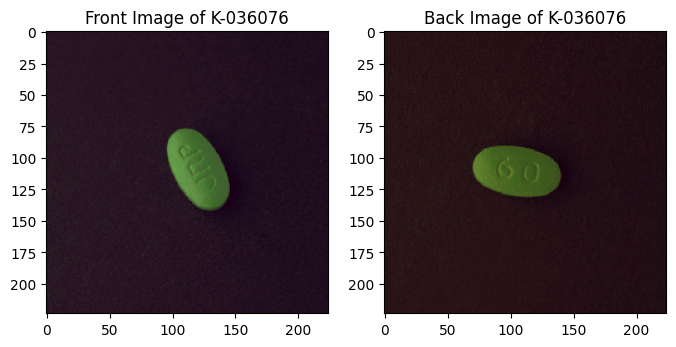

Label: K-036079, Index: 26


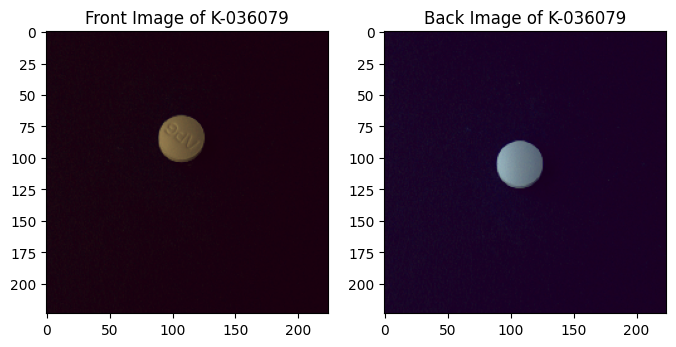

Label: K-036085, Index: 27


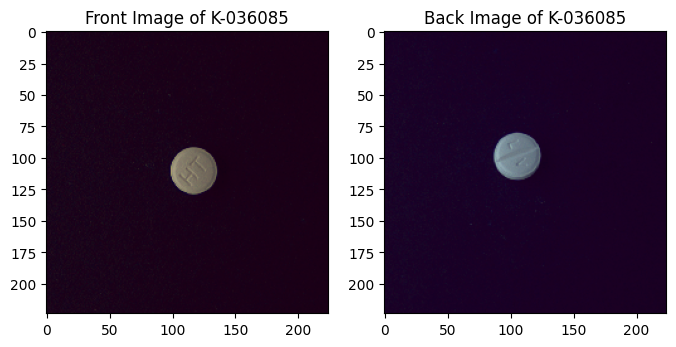

Label: K-036098, Index: 28


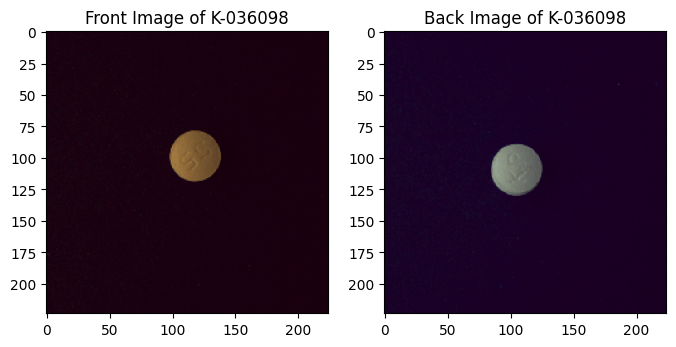

Label: K-036107, Index: 29


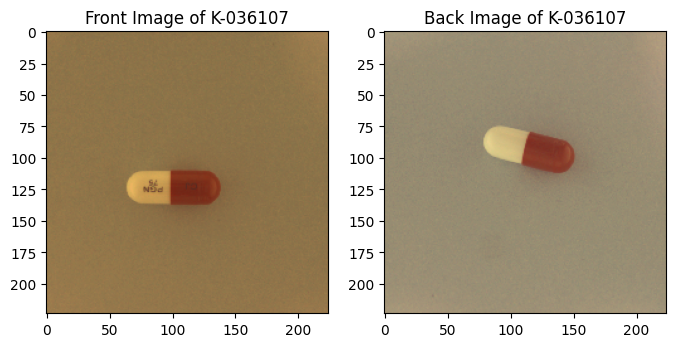

Label: K-036117, Index: 30


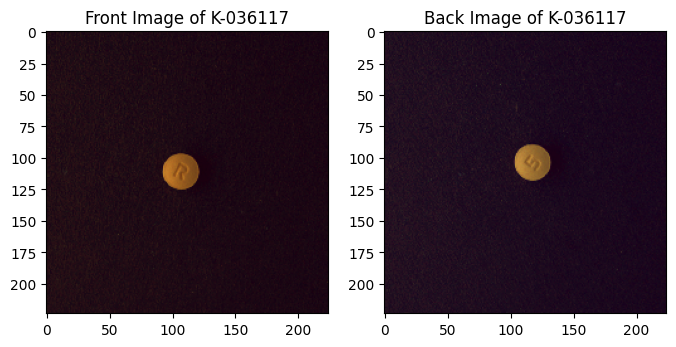

Label: K-036129, Index: 31


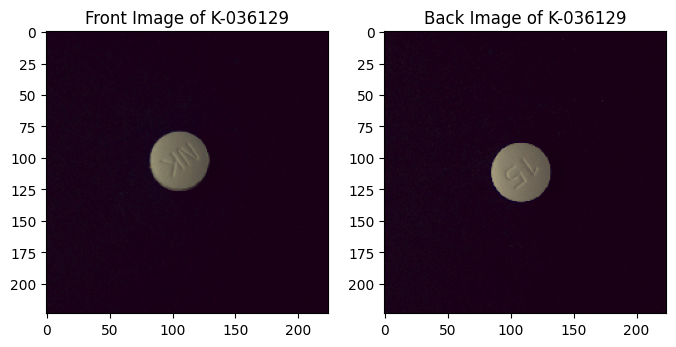

Label: K-036130, Index: 32


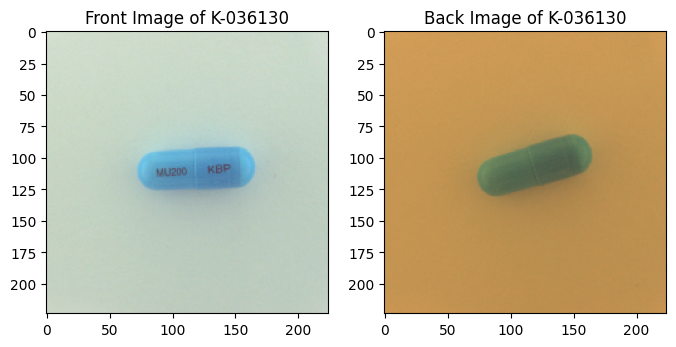

Label: K-036140, Index: 33


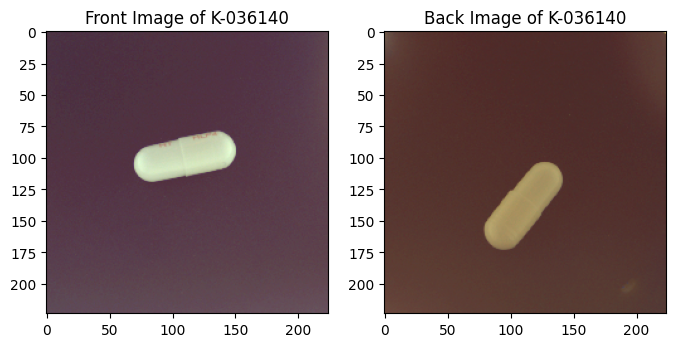

Label: K-036176, Index: 34


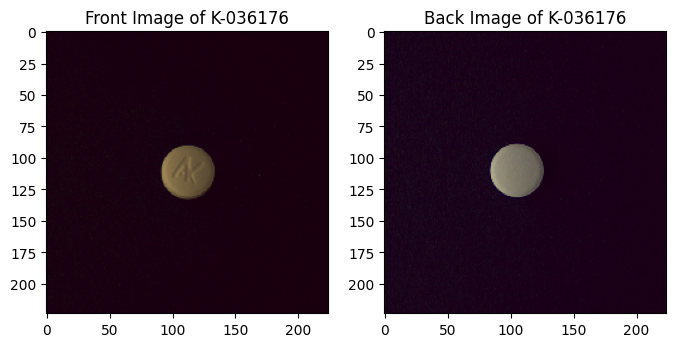

Label: K-036179, Index: 35


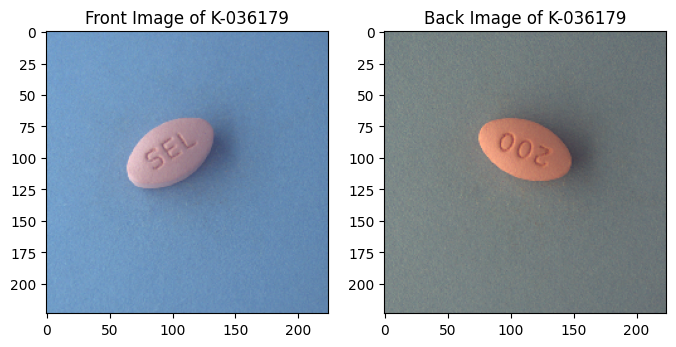

Label: K-036185, Index: 36


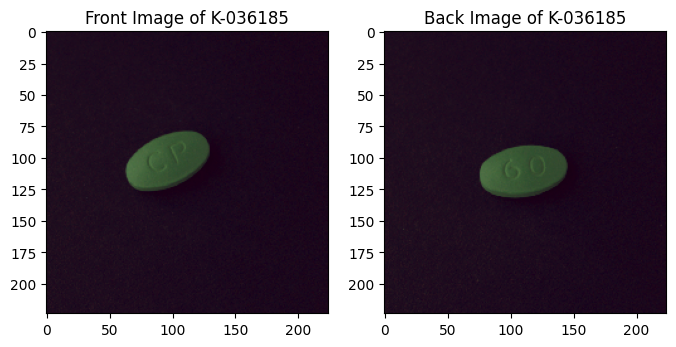

Label: K-036213, Index: 37


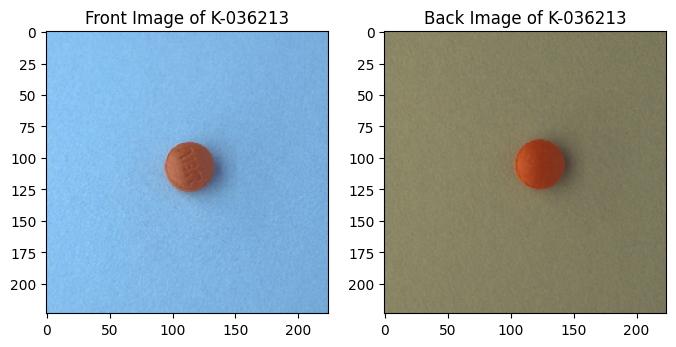

Label: K-036232, Index: 38


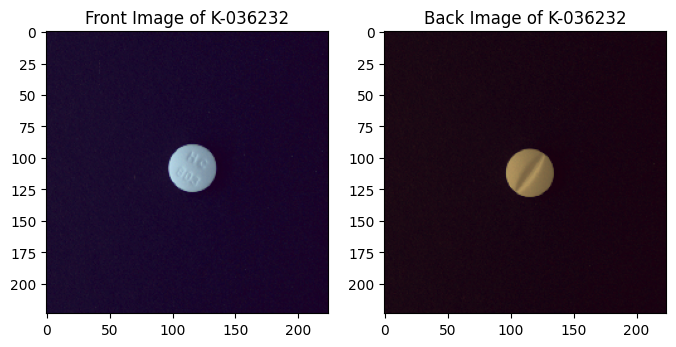

Label: K-035811, Index: 39


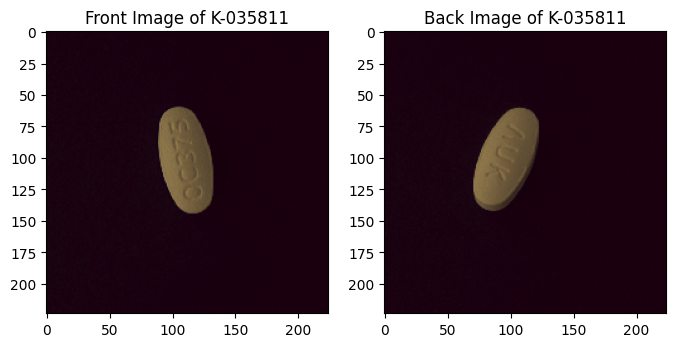

Label: K-035815, Index: 40


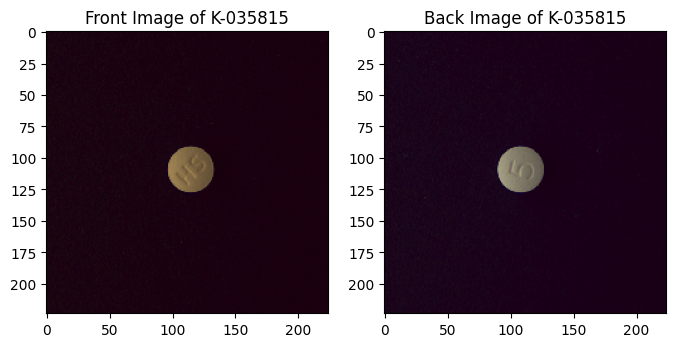

Label: K-035769, Index: 41


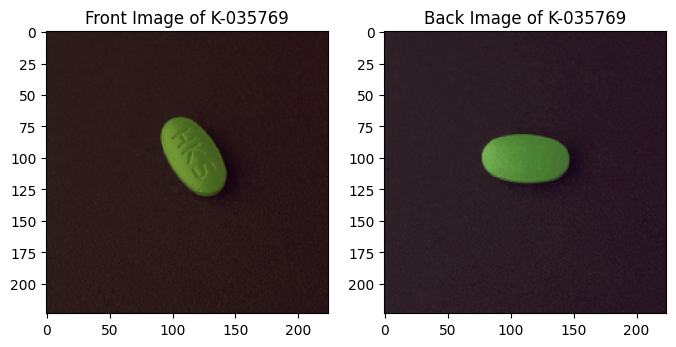

Label: K-035770, Index: 42


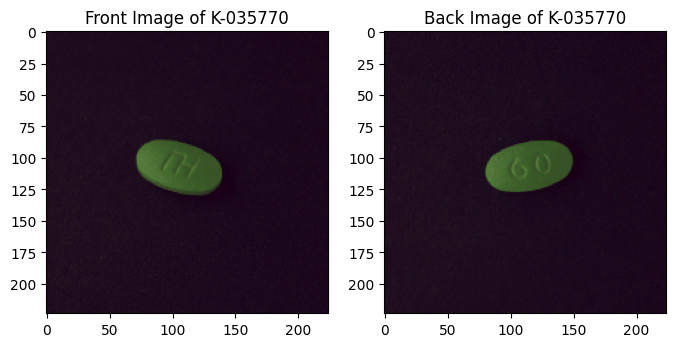

Label: K-035780, Index: 43


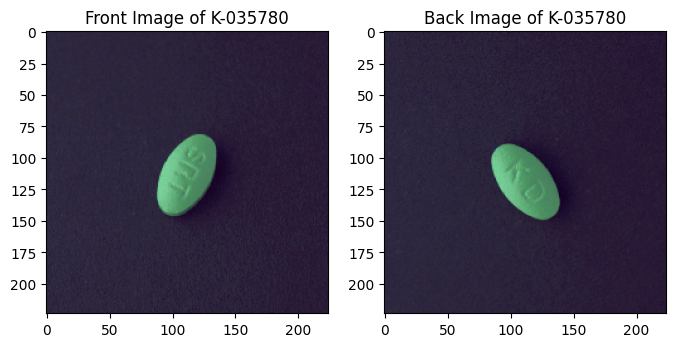

Label: K-035788, Index: 44


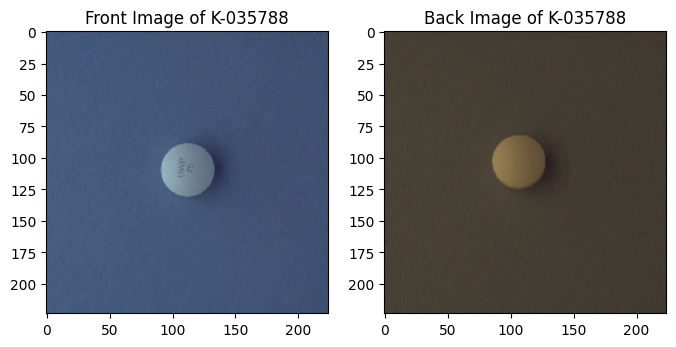

Label: K-035791, Index: 45


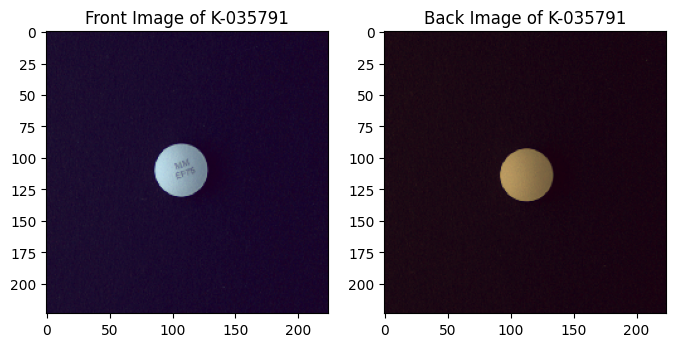

Label: K-035792, Index: 46


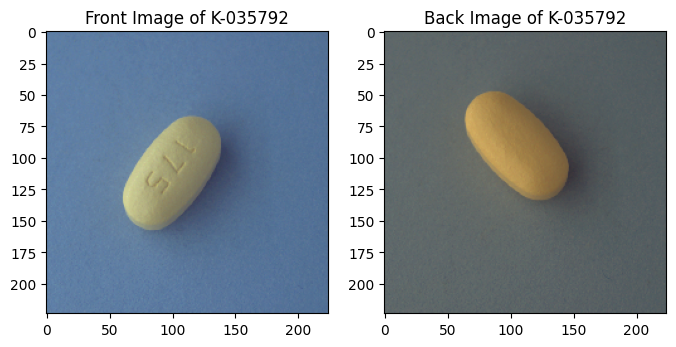

Label: K-035798, Index: 47


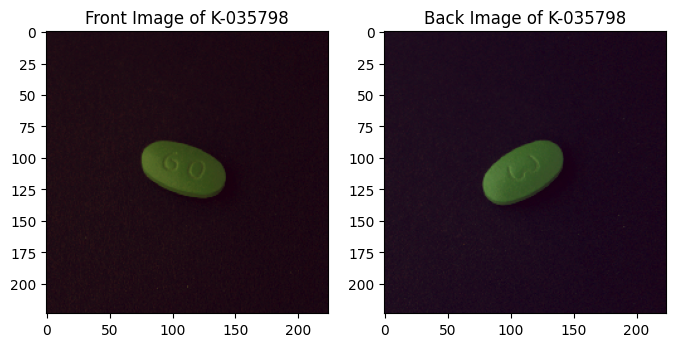

Label: K-035802, Index: 48


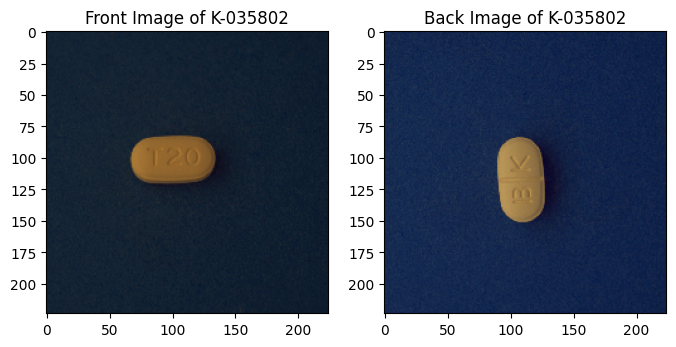

Label: K-035881, Index: 49


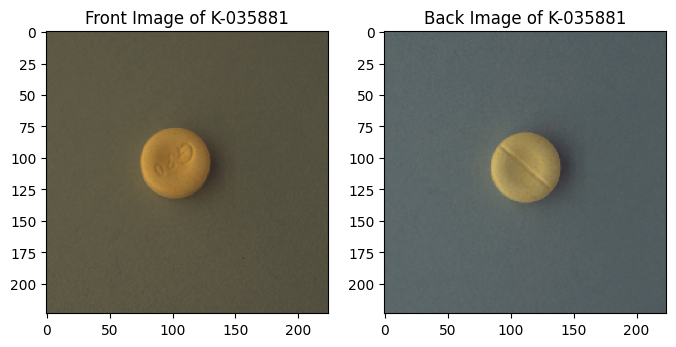

Label: K-035856, Index: 50


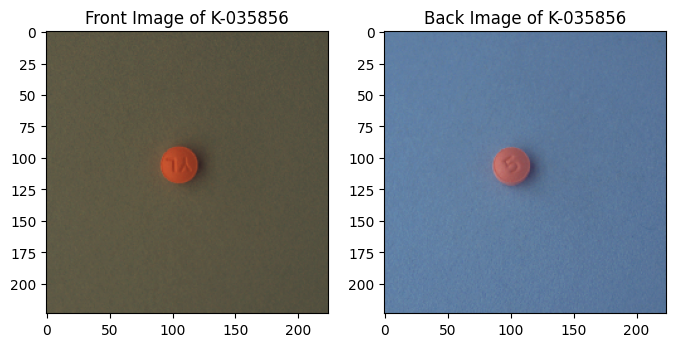

Label: K-035833, Index: 51


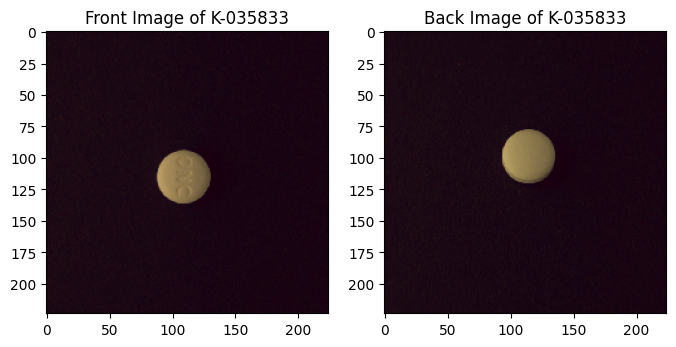

Label: K-035923, Index: 52


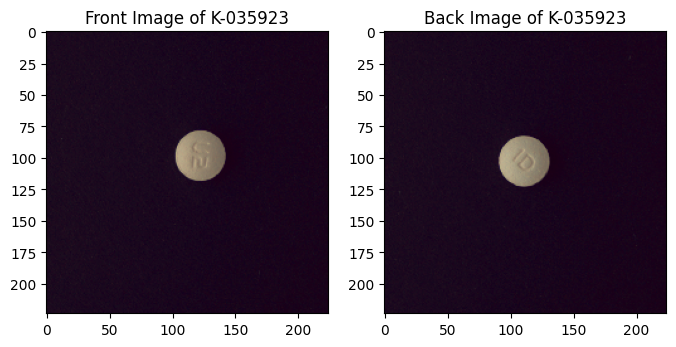

Label: K-035957, Index: 53


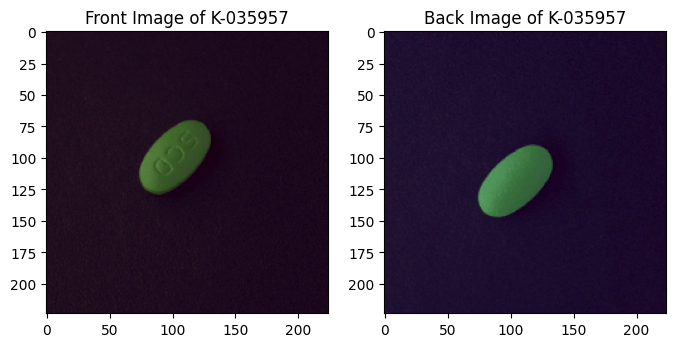

Label: K-035934, Index: 54


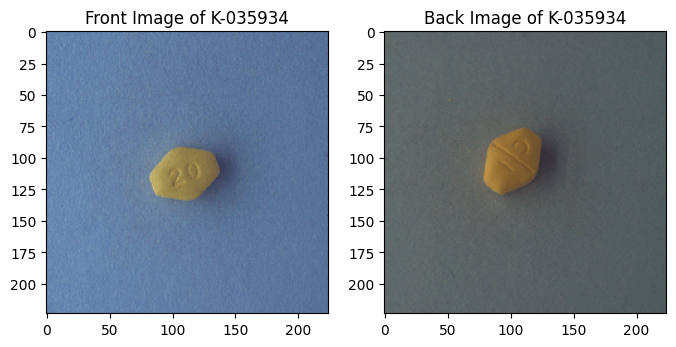

Label: K-035905, Index: 55


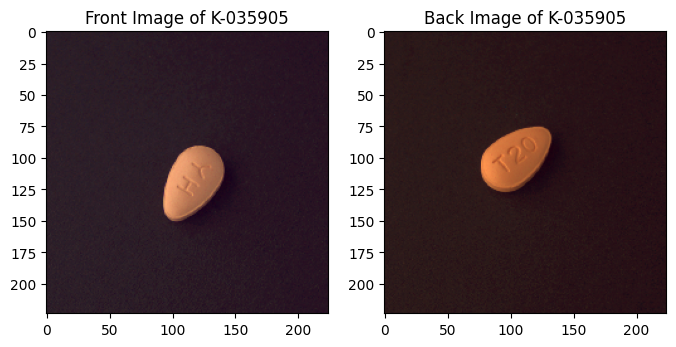

Label: K-035914, Index: 56


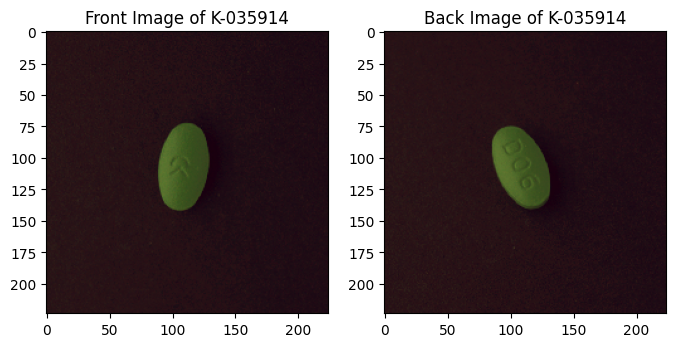

Label: K-035970, Index: 57


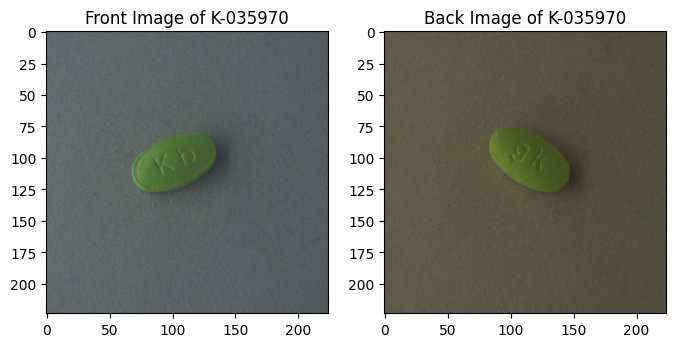

Label: K-035982, Index: 58


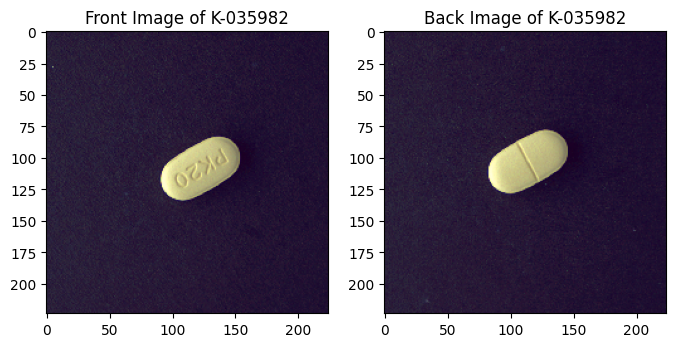

Label: K-035730, Index: 59


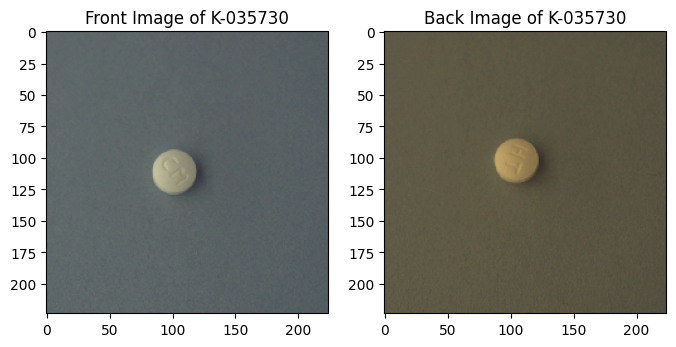

Label: K-035736, Index: 60


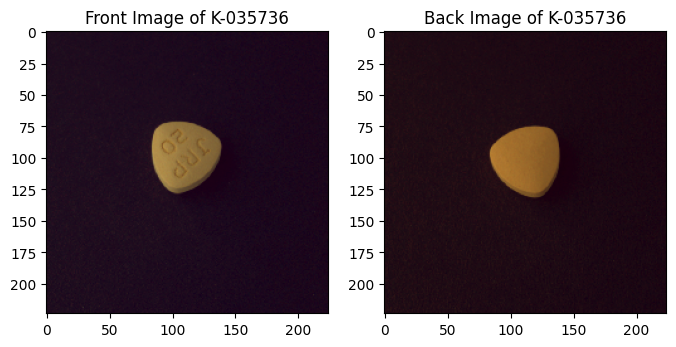

Label: K-011111, Index: 61


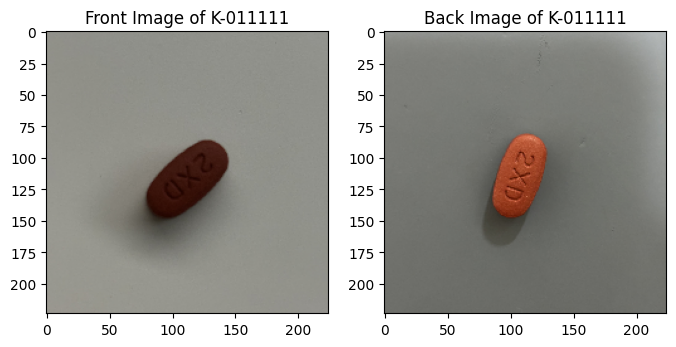

Label: K-021111, Index: 62


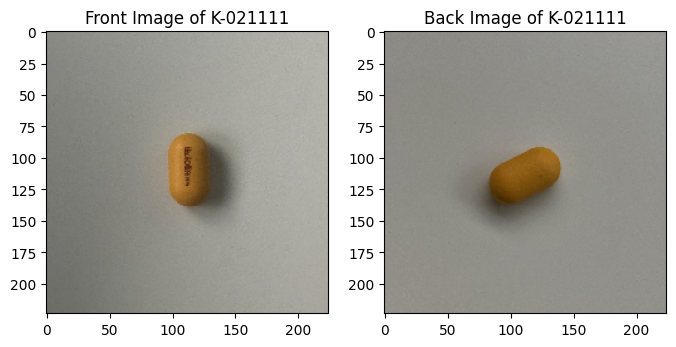

Label: K-058694, Index: 63


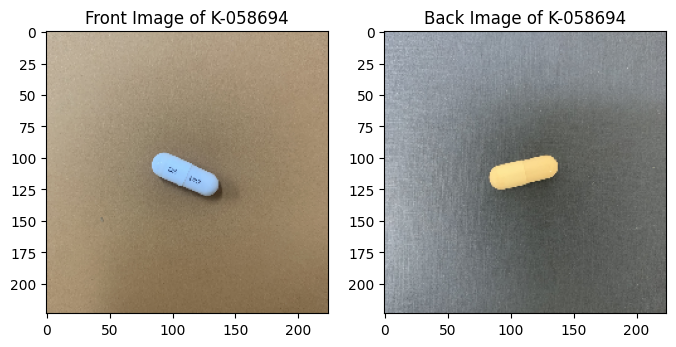

Label: K-058699, Index: 64


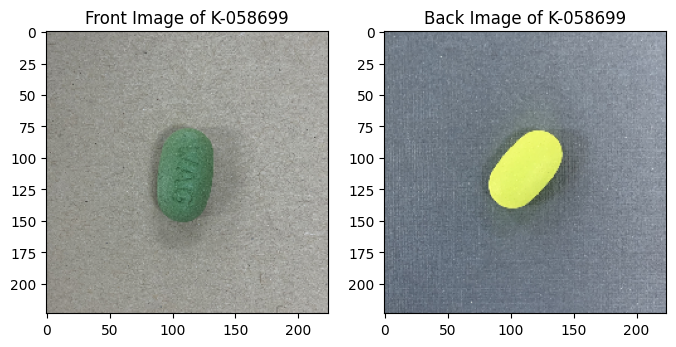

Label: K-099999, Index: 65


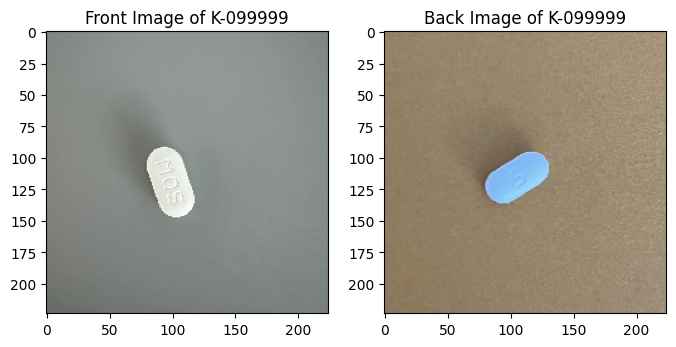

Label: K-088888, Index: 66


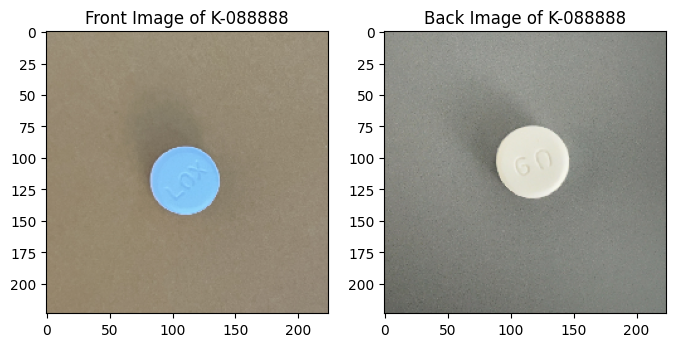

Label: K-077777, Index: 67


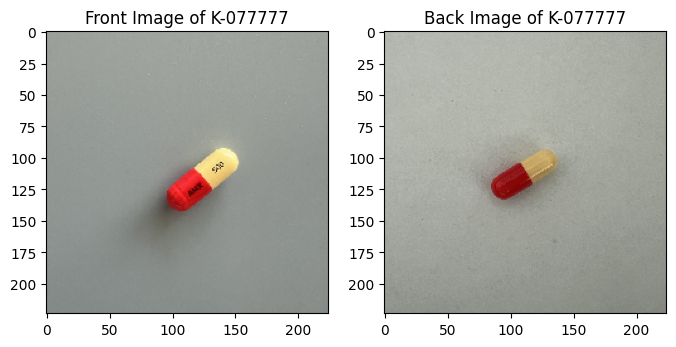

Label: K-023455, Index: 68


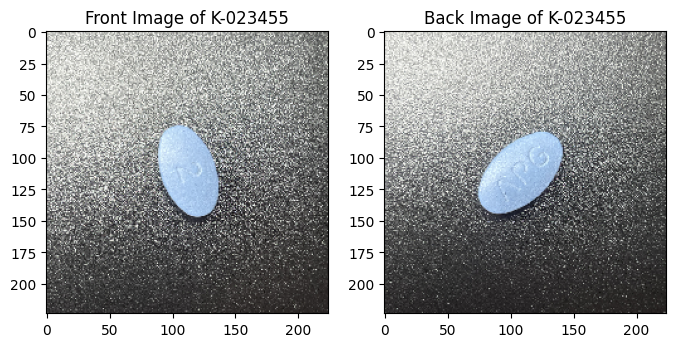

Label: K-012345, Index: 69


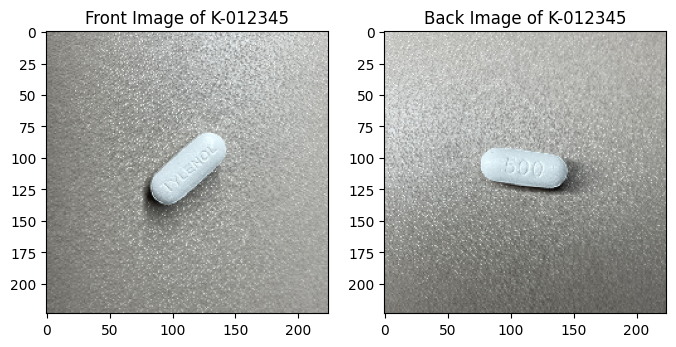

In [ ]:
import os
import random
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array

def verify_labels(data_dir, label_map):
    """
    각 클래스 폴더에서 이미지를 불러와서 라벨링이 올바른지 확인하는 함수
    :param data_dir: 이미지 데이터 디렉토리 경로
    :param label_map: 라벨 맵 딕셔너리
    """
    for label, idx in label_map.items():
        front_images_dir = os.path.join(data_dir, label, 'front_size')
        back_images_dir = os.path.join(data_dir, label, 'back_size')

        if not os.path.isdir(front_images_dir) or not os.path.isdir(back_images_dir):
            print(f"Skipping {label} as front_size or back_size directory does not exist.")
            continue

        front_images = os.listdir(front_images_dir)
        back_images = os.listdir(back_images_dir)

        if not front_images or not back_images:
            print(f"No images found in {label}.")
            continue

        front_image_path = os.path.join(front_images_dir, random.choice(front_images))
        back_image_path = os.path.join(back_images_dir, random.choice(back_images))

        front_image = load_img(front_image_path, target_size=(224, 224))
        back_image = load_img(back_image_path, target_size=(224, 224))

        front_array = img_to_array(front_image) / 255.0
        back_array = img_to_array(back_image) / 255.0

        print(f"Label: {label}, Index: {idx}")
        plt.figure(figsize=(8, 4))

        plt.subplot(1, 2, 1)
        plt.imshow(front_image)
        plt.title(f"Front Image of {label}")

        plt.subplot(1, 2, 2)
        plt.imshow(back_image)
        plt.title(f"Back Image of {label}")

        plt.show()

# 라벨 맵을 로드
data_dir = '/content/gdrive/MyDrive/pill-today/pill-ai/pill/EDA/Data/data_100/train/'
label_map = {label: idx for idx, label in enumerate(os.listdir(data_dir))}

# 라벨 확인
verify_labels(data_dir, label_map)


In [ ]:
import json
import os

def save_label_map(label_map, file_path):
    # label_map의 키를 문자열로 변환하여 저장합니다.
    label_map_str_keys = {str(k): v for k, v in label_map.items()}
    with open(file_path, 'w') as f:
        json.dump(label_map_str_keys, f)

# 데이터 디렉토리 경로
data_dir = '/content/gdrive/MyDrive/pill-today/pill-ai/pill/EDA/Data/data_100/train/'

# 라벨 맵 생성
label_map = {label: idx for idx, label in enumerate(os.listdir(data_dir))}

# 저장할 파일 경로
label_map_path = '/content/gdrive/MyDrive/pill-today/pill-ai/pill/EDA/Data/data_100/label_map_ver2.json'

# 라벨 맵 저장
save_label_map(label_map, label_map_path)
print(f"Label map saved to {label_map_path}")


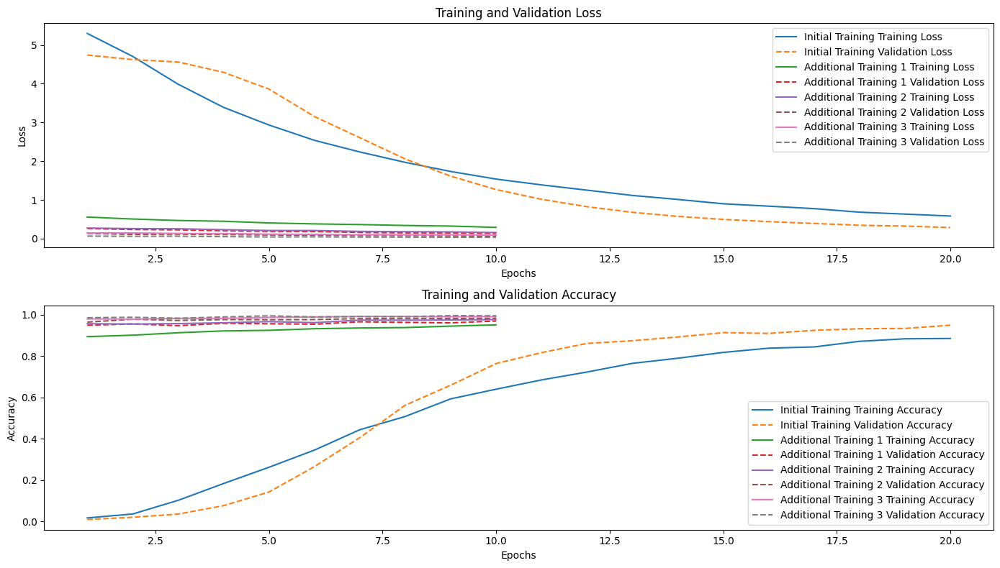

In [ ]:
import matplotlib.pyplot as plt

def plot_training_history(histories, titles):
    """
    여러 학습 히스토리를 플로팅하는 함수

    :param histories: 학습 히스토리 객체들의 리스트
    :param titles: 각 히스토리에 대한 제목 리스트
    """
    epochs = range(1, len(histories[0].history['loss']) + 1)

    plt.figure(figsize=(14, 8))

    # 손실 그래프
    plt.subplot(2, 1, 1)
    for idx, history in enumerate(histories):
        epochs = range(1, len(history.history['loss']) + 1)
        plt.plot(epochs, history.history['loss'], label=f'{titles[idx]} Training Loss')
        plt.plot(epochs, history.history['val_loss'], label=f'{titles[idx]} Validation Loss', linestyle='--')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    # 정확도 그래프
    plt.subplot(2, 1, 2)
    for idx, history in enumerate(histories):
        epochs = range(1, len(history.history['accuracy']) + 1)
        plt.plot(epochs, history.history['accuracy'], label=f'{titles[idx]} Training Accuracy')
        plt.plot(epochs, history.history['val_accuracy'], label=f'{titles[idx]} Validation Accuracy', linestyle='--')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()

    plt.tight_layout()
    plt.show()

# 학습 히스토리를 리스트로 만듭니다.
histories = [history, history_additional, history_additional_2, history_additional_3]
titles = ['Initial Training', 'Additional Training 1', 'Additional Training 2', 'Additional Training 3']

# 학습 히스토리 플로팅
plot_training_history(histories, titles)


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

# 예측값 생성
y_true = []
y_pred = []

for i in range(len(validation_generator)):
    X, y = validation_generator[i]
    preds = model.predict(X)
    y_true.extend(np.argmax(y, axis=1))
    y_pred.extend(np.argmax(preds, axis=1))

print(classification_report(y_true, y_pred))
print(confusion_matrix(y_true, y_pred))


1/1 [==============================] - 0s 36ms/step
              precision    recall  f1-score   support

           0       1.00      0.95      0.97        19
           1       1.00      0.85      0.92        20
           2       1.00      1.00      1.00        20
           3       0.95      0.90      0.92        20
           4       1.00      1.00      1.00        18
           5       1.00      1.00      1.00        20
           6       1.00      1.00      1.00        20
           7       1.00      1.00      1.00        20
           8       1.00      1.00      1.00        20
           9       1.00      1.00      1.00        20
          10       1.00      1.00      1.00        20
          11       1.00      0.95      0.97        20
          12       0.95      1.00      0.97        19
          13       1.00      1.00      1.00        20
          14       1.00      1.00      1.00        19
          15       0.90      0.90      0.90        20
          16       0.90      

In [ ]:
from tensorflow.keras.models import model_from_json

# 모델 구조 불러오기
json_file_path = '/content/gdrive/MyDrive/pill-today/pill-ai/pill/model/saved_model_mobilenetv2/model_ver1.json'
with open(json_file_path, 'r') as json_file:
    model_json = json_file.read()
model = model_from_json(model_json)

# 모델 가중치 불러오기
weights_file_path = '/content/gdrive/MyDrive/pill-today/pill-ai/pill/model/saved_model_mobilenetv2/model_weights_ver1.h5'
model.load_weights(weights_file_path)

# 모델 컴파일 (모델을 평가하기 위해서는 컴파일이 필요합니다)
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
# 모델 평가
test_loss, test_acc = model.evaluate(test_generator)
print(f"Test Accuracy: {test_acc*100:.2f}%")

43/43 [==============================] - 628s 15s/step - loss: 0.0331 - accuracy: 0.9920
Test Accuracy: 99.20%


In [ ]:
import json
import os

def save_label_map(label_map, file_path):
    # label_map의 키를 문자열로 변환하여 저장합니다.
    label_map_str_keys = {str(k): v for k, v in label_map.items()}
    with open(file_path, 'w') as f:
        json.dump(label_map_str_keys, f)

# 데이터 디렉토리 경로
data_dir = '/content/gdrive/MyDrive/pill-today/pill-ai/pill/EDA/Data/data_100/train/'

# 라벨 맵 생성
label_map = {label: idx for idx, label in enumerate(os.listdir(data_dir))}

# 저장할 파일 경로
label_map_path = '/content/gdrive/MyDrive/pill-today/pill-ai/pill/EDA/Data/data_100/label_map_ver1.json'

# 라벨 맵 저장
save_label_map(label_map, label_map_path)
print(f"Label map saved to {label_map_path}")


Label map saved to /content/gdrive/MyDrive/pill-today/pill-ai/pill/EDA/Data/data_100/label_map_ver1.json
